In [11]:
from sklearn.model_selection import train_test_split
from tensorflow.keras.layers import Dense, LSTM, Dropout
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
from keras.callbacks import CSVLogger
import tensorflow as tf

In [12]:
import pandas as pd

# Importing Cleaned Data

df = pd.read_excel('../dataset/Dataset setelah preprocessing.xlsx')
df

,Link,Judul,Tanggal,Tanggal(2),Penulis,Isi,Label,Label 2
0,https://investasi.kontan.co.id/news/miliarder-...,"Miliarder ini sangat yakin, harga Bitcoin baka...","Jumat, 01 Oktober 2021 / 23:00 WIB",01 Oktober 2021,S.S. Kurniawan,orlando bravo miliarder diri usaha ekuitas tho...,positif,negatif
1,https://investasi.kontan.co.id/news/sinar-mas-...,Sinar Mas Agro (SMAR) menerbitkan obligasi tot...,"Jumat, 01 Oktober 2021 / 22:36 WIB",01 Oktober 2021,Wahyu T.Rahmawati,terbit obligasi obligasi lanjut smart target d...,positif,negatif
2,https://investasi.kontan.co.id/news/menghadapi...,"Menghadapi saham berpotensi delisting, ini yan...","Jumat, 01 Oktober 2021 / 22:17 WIB",01 Oktober 2021,Wahyu T.Rahmawati,wawan opsi tempuh lanjur masuk potensi delisti...,positif,negatif
3,https://investasi.kontan.co.id/news/wall-stree...,"Wall Street bervariasi, investor mencari pelua...","Jumat, 01 Oktober 2021 / 21:24 WIB",01 Oktober 2021,Wahyu T.Rahmawati,mata data aktivitas pabrik tanda tanda sehat e...,positif,negatif
4,https://investasi.kontan.co.id/news/investor-a...,Investor asing mencatat net sell terbesar pada...,"Jumat, 01 Oktober 2021 / 21:12 WIB",01 Oktober 2021,Noverius Laoli,kendati asing catat net jumbo mere total volum...,positif,negatif
...,...,...,...,...,...,...,...,...
4003,https://investasi.kontan.co.id/news/rupiah-jis...,"Rupiah Jisdor Melemah 0,33% ke Rp 14.592 Per D...","Selasa, 31 Mei 2022 / 15:29 WIB",31 Mei 2022,Herlina Kartika Dewi,dolar amerika serikat selasa lemah hari dolar ...,negatif,positif
4004,https://investasi.kontan.co.id/news/bangun-eko...,"Bangun Ekosistem Digital, TELE Catat Pertumbuh...","Selasa, 31 Mei 2022 / 15:17 WIB",31 Mei 2022,Handoyo .,presiden direktur salim persero fokus tata bis...,negatif,positif
4005,https://investasi.kontan.co.id/news/ihsg-mengu...,"IHSG Menguat 1,58% ke 7.148 di Akhir Perdagang...","Selasa, 31 Mei 2022 / 15:16 WIB",31 Mei 2022,Herlina Kartika Dewi,jual bersih besar asing indocement tunggal pra...,negatif,positif
4006,https://investasi.kontan.co.id/news/mark-dynam...,Mark Dynamics Indonesia (MARK) Putuskan Tebar ...,"Selasa, 31 Mei 2022 / 14:08 WIB",31 Mei 2022,Noverius Laoli,empat bagi dividen silam dividen persentase ja...,negatif,positif


In [13]:
df = df.drop(['Link','Judul','Tanggal','Penulis','Label 2'],1)
df

C:\Users\Muhith\AppData\Local\Temp/ipykernel_19484/59990735.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  df = df.drop(['Link','Judul','Tanggal','Penulis','Label 2'],1)


,Tanggal(2),Isi,Label
0,01 Oktober 2021,orlando bravo miliarder diri usaha ekuitas tho...,positif
1,01 Oktober 2021,terbit obligasi obligasi lanjut smart target d...,positif
2,01 Oktober 2021,wawan opsi tempuh lanjur masuk potensi delisti...,positif
3,01 Oktober 2021,mata data aktivitas pabrik tanda tanda sehat e...,positif
4,01 Oktober 2021,kendati asing catat net jumbo mere total volum...,positif
...,...,...,...
4003,31 Mei 2022,dolar amerika serikat selasa lemah hari dolar ...,negatif
4004,31 Mei 2022,presiden direktur salim persero fokus tata bis...,negatif
4005,31 Mei 2022,jual bersih besar asing indocement tunggal pra...,negatif
4006,31 Mei 2022,empat bagi dividen silam dividen persentase ja...,negatif


In [14]:
mapping = {item:i for i, item in enumerate(df['Tanggal(2)'].unique())}
df["id_tgl"] = df["Tanggal(2)"].apply(lambda x: mapping[x])
df

,Tanggal(2),Isi,Label,id_tgl
0,01 Oktober 2021,orlando bravo miliarder diri usaha ekuitas tho...,positif,0
1,01 Oktober 2021,terbit obligasi obligasi lanjut smart target d...,positif,0
2,01 Oktober 2021,wawan opsi tempuh lanjur masuk potensi delisti...,positif,0
3,01 Oktober 2021,mata data aktivitas pabrik tanda tanda sehat e...,positif,0
4,01 Oktober 2021,kendati asing catat net jumbo mere total volum...,positif,0
...,...,...,...,...
4003,31 Mei 2022,dolar amerika serikat selasa lemah hari dolar ...,negatif,215
4004,31 Mei 2022,presiden direktur salim persero fokus tata bis...,negatif,215
4005,31 Mei 2022,jual bersih besar asing indocement tunggal pra...,negatif,215
4006,31 Mei 2022,empat bagi dividen silam dividen persentase ja...,negatif,215


In [15]:
df = df[['id_tgl', 'Tanggal(2)', 'Isi', 'Label']]
df

,id_tgl,Tanggal(2),Isi,Label
0,0,01 Oktober 2021,orlando bravo miliarder diri usaha ekuitas tho...,positif
1,0,01 Oktober 2021,terbit obligasi obligasi lanjut smart target d...,positif
2,0,01 Oktober 2021,wawan opsi tempuh lanjur masuk potensi delisti...,positif
3,0,01 Oktober 2021,mata data aktivitas pabrik tanda tanda sehat e...,positif
4,0,01 Oktober 2021,kendati asing catat net jumbo mere total volum...,positif
...,...,...,...,...
4003,215,31 Mei 2022,dolar amerika serikat selasa lemah hari dolar ...,negatif
4004,215,31 Mei 2022,presiden direktur salim persero fokus tata bis...,negatif
4005,215,31 Mei 2022,jual bersih besar asing indocement tunggal pra...,negatif
4006,215,31 Mei 2022,empat bagi dividen silam dividen persentase ja...,negatif


In [16]:
df['Label'].value_counts()

positif    2275
negatif    1733
Name: Label, dtype: int64

In [17]:
# map classes into 0 for negative and 1 for positive

df['Label'] = df['Label'].replace(['positif','negatif'],[1,0])
df

,id_tgl,Tanggal(2),Isi,Label
0,0,01 Oktober 2021,orlando bravo miliarder diri usaha ekuitas tho...,1
1,0,01 Oktober 2021,terbit obligasi obligasi lanjut smart target d...,1
2,0,01 Oktober 2021,wawan opsi tempuh lanjur masuk potensi delisti...,1
3,0,01 Oktober 2021,mata data aktivitas pabrik tanda tanda sehat e...,1
4,0,01 Oktober 2021,kendati asing catat net jumbo mere total volum...,1
...,...,...,...,...
4003,215,31 Mei 2022,dolar amerika serikat selasa lemah hari dolar ...,0
4004,215,31 Mei 2022,presiden direktur salim persero fokus tata bis...,0
4005,215,31 Mei 2022,jual bersih besar asing indocement tunggal pra...,0
4006,215,31 Mei 2022,empat bagi dividen silam dividen persentase ja...,0


In [18]:
# Check Frequent Words from the dataset

from collections import Counter

cnt = Counter()
for text in df["Isi"].values:
    for word in text.split():
        cnt[word] += 1
    
print('Number of Features : ',len(cnt.most_common()))

Number of Features :  9337


In [19]:
from sklearn.feature_extraction.text import CountVectorizer

count_vect = CountVectorizer(max_features = 1000)
X_train_counts = count_vect.fit_transform(df['Isi'])

In [20]:
from sklearn.feature_extraction.text import TfidfTransformer

tfidf_transformer = TfidfTransformer()
X_train_tfidf = tfidf_transformer.fit_transform(X_train_counts)
X_train_tfidf.shape

(4008, 1000)

In [21]:
print(X_train_tfidf[0][0])

  (0, 968)	0.09094129965992373
  (0, 936)	0.187136727049183
  (0, 895)	0.14690319322633985
  (0, 832)	0.20111085143750998
  (0, 824)	0.15655507546665434
  (0, 810)	0.16442323148756358
  (0, 783)	0.13113963229059905
  (0, 711)	0.2235811958332695
  (0, 671)	0.21080326652735817
  (0, 620)	0.18455362284594634
  (0, 616)	0.2245316718145256
  (0, 562)	0.10820954980011427
  (0, 499)	0.16169433040421938
  (0, 462)	0.3284132891173964
  (0, 388)	0.21513527442847497
  (0, 289)	0.17618871774534153
  (0, 230)	0.22174481754268058
  (0, 216)	0.31064587657940795
  (0, 204)	0.21149376822130705
  (0, 185)	0.11611779157520288
  (0, 184)	0.13076034907710918
  (0, 178)	0.12820063710271185
  (0, 145)	0.10127930997388583
  (0, 136)	0.11848460706600211
  (0, 123)	0.2265024707464894
  (0, 122)	0.19285846815196944
  (0, 110)	0.12741116509084255
  (0, 91)	0.18455362284594634
  (0, 83)	0.15329439329292865


In [22]:
X_train_tfidf = X_train_tfidf.toarray()

In [23]:
News_per_date_taken = 10

In [24]:
tempo = df[df['id_tgl'] == 0].tail(News_per_date_taken)
temp_list = [X_train_tfidf[j] for j in tempo.index]
temp_list

[array([0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.14928644, 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.14242155, 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.        , 0.        ,
        0.        , 0.        , 0.        , 0.  

In [25]:
unique_tanggalids = df['id_tgl'].unique()
news_per_date_id = {} #This will store the lates 10 news for each id_tgl.


for i in unique_tanggalids:
  temp = df[df['id_tgl'] == i].tail(News_per_date_taken)#Taking the last 10 i.e latest 10 news per date.
  
  temp_list = [X_train_tfidf[j] for j in temp.index]#appending the latest 10 news in a list
  
  news_per_date_id[i] = temp_list #appending just the 10 news per id tgl
  
  """
  now dictionary will be like this 
  notes_per_date_id = {2 : ['first news', 'second news'.. upto 8 news]}
  for each tgl_id
  This will directly contain the vectors of each news and not the text of the news
  """

In [26]:
import numpy as np

for i in unique_tanggalids:
  if len(news_per_date_id[i]) < News_per_date_taken:#checking if length of news for 
    #a tgl id is less than the length that we determined before.
    number_of_padded_lists = News_per_date_taken - len(news_per_date_id[i])
    #How many padded zeros will be required for that id_tgl
    t = [np.zeros(1000, dtype = float) for i in range(number_of_padded_lists)]
    #Getting padded lists, with 1000 as dimension for our TFIDF is 1000, Change this according to your dimension of TFIDF.
    news_per_date_id[i] = np.array(t + news_per_date_id[i])
    #Appending and making the input uniform.

In [27]:
news_per_date_id

{0: [array([0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.14928644, 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.14242155, 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        

In [28]:
data_dim = 1000

#tunable parameter
batch_size = 50
epochs = 15

In [29]:
x_train_lstm = np.array([news_per_date_id[i] for i in news_per_date_id])
y_lstm = []
for i in unique_tanggalids:
  temp = df[df['id_tgl'] == i]['Label']
  temp.index = range(len(temp))
  y_lstm.append(temp[0])
  
y_lstm = np.array(y_lstm)

In [30]:
x_train_lstm.shape

(216, 10, 1000)

In [31]:
print("Length of train set is",len(x_train_lstm))
print("Length of label set is",len(y_lstm))

Length of train set is 216
Length of label set is 216


In [32]:
unique, counts = np.unique(y_lstm, return_counts=True)

print(np.asarray((unique, counts)).T)

[[  0  92]
 [  1 124]]


In [33]:
x_train, x_test, y_train, y_test = train_test_split(x_train_lstm, y_lstm, test_size=0.2, random_state=42)

In [83]:
print(x_train.shape, x_test.shape)
print(y_train.shape, y_test.shape)

(172, 10, 1000) (44, 10, 1000)
(172,) (44,)


In [84]:
unique1, counts1 = np.unique(y_train, return_counts=True)

print(np.asarray((unique1, counts1)).T)

unique2, counts2 = np.unique(y_test, return_counts=True)

print(np.asarray((unique2, counts2)).T)

[[  0  71]
 [  1 101]]
[[ 0 21]
 [ 1 23]]


In [99]:
# Arsitektur Model

model = Sequential()
model.add(LSTM(64, input_shape=(None, 1000)))
model.add(Dropout(0.1))
model.add(Dense(256, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics = ['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])
model.summary()

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_13 (LSTM)              (None, 64)                272640    
                                                                 
 dropout_13 (Dropout)        (None, 64)                0         
                                                                 
 dense_38 (Dense)            (None, 256)               16640     
                                                                 
 dense_39 (Dense)            (None, 128)               32896     
                                                                 
 dense_40 (Dense)            (None, 1)                 129       
                                                                 
Total params: 322,305
Trainable params: 322,305
Non-trainable params: 0
_________________________________________________________________


In [9]:
## Save training history kedalam .log file 

# csv_logger = CSVLogger('training8.log', separator=',', append=False)
# history = model.fit(x_train,y_train,validation_data=(x_test,y_test),batch_size=64, epochs=10, callbacks=[csv_logger])

In [10]:
## Saving model

# model.save('training8')

In [125]:
# Load model yang sudah di save => model 4

from tensorflow import keras

model = keras.models.load_model('training4')

In [127]:
# menunjukkan hasil akurasi dari model menggunakan batch size 32 dan epochs 8

log_data4 = pd.read_csv('training4.log', sep=',', engine='python')
log_data4['val_f1_score'] = (2 * log_data4['val_precision_16'] * log_data4['val_recall_16'])/(log_data4['val_precision_16'] + log_data4['val_recall_16'])
log_data4['f1_score'] = (2 * log_data4['precision_16'] * log_data4['recall_16'])/(log_data4['precision_16'] + log_data4['recall_16'])
log_data4

,epoch,accuracy,loss,precision_16,recall_16,val_accuracy,val_loss,val_precision_16,val_recall_16,val_f1_score,f1_score
0,0,0.582474,0.690273,0.580645,0.972973,0.590909,0.685829,0.590909,1.000000,0.742857,0.727273
1,1,0.572165,0.677209,0.572165,1.000000,0.590909,0.679133,0.590909,1.000000,0.742857,0.727869
2,2,0.572165,0.662175,0.572165,1.000000,0.590909,0.683458,0.590909,1.000000,0.742857,0.727869
3,3,0.572165,0.645985,0.572165,1.000000,0.590909,0.678569,0.590909,1.000000,0.742857,0.727869
4,4,0.592784,0.590157,0.584211,1.000000,0.590909,0.684454,0.590909,1.000000,0.742857,0.737542
5,5,0.670103,0.498976,0.634286,1.000000,0.454545,0.687340,0.526316,0.769231,0.625000,0.776224
6,6,0.922680,0.342771,0.887097,0.990991,0.454545,0.908385,0.526316,0.769231,0.625000,0.936170
7,7,0.974227,0.186207,0.956897,1.000000,0.500000,0.977337,0.625000,0.384615,0.476190,0.977974


<h1> Eksperimen Batch size dan Epochs </h1>

In [1]:
log_data1 = pd.read_csv('training1.log', sep=',', engine='python')
log_data2 = pd.read_csv('training2.log', sep=',', engine='python')
log_data3 = pd.read_csv('training3.log', sep=',', engine='python')
log_data5 = pd.read_csv('training5.log', sep=',', engine='python')
log_data6 = pd.read_csv('training6.log', sep=',', engine='python')
log_data7 = pd.read_csv('training7.log', sep=',', engine='python')
log_data8 = pd.read_csv('training8.log', sep=',', engine='python')
log_data9 = pd.read_csv('training9.log', sep=',', engine='python')

In [2]:
hasil = []
hasil.append(log_data1.tail(1).values)
hasil.append(log_data2.tail(1).values)
hasil.append(log_data3.tail(1).values)
hasil.append(log_data5.tail(1).values)
hasil.append(log_data6.tail(1).values)
hasil.append(log_data7.tail(1).values)
hasil.append(log_data8.tail(1).values)
hasil.append(log_data9.tail(1).values)

In [3]:
columns = ['epochs','accuracy','loss','precision','recall','val_accuracy','val_loss','val_precision','val_recall']

df_hasil_eksperimen1 = pd.DataFrame(hasil[0],columns=columns)
df_hasil_eksperimen2 = pd.DataFrame(hasil[1],columns=columns)
df_hasil_eksperimen3 = pd.DataFrame(hasil[2],columns=columns)
df_hasil_eksperimen4 = pd.DataFrame(hasil[3],columns=columns)
df_hasil_eksperimen5 = pd.DataFrame(hasil[4],columns=columns)
df_hasil_eksperimen6 = pd.DataFrame(hasil[5],columns=columns)
df_hasil_eksperimen7 = pd.DataFrame(hasil[6],columns=columns)
df_hasil_eksperimen8 = pd.DataFrame(hasil[7],columns=columns)

In [4]:
# Combine the eight dataframes

df_hasil_eksperimen = pd.concat([df_hasil_eksperimen1,df_hasil_eksperimen2,df_hasil_eksperimen3,df_hasil_eksperimen4,df_hasil_eksperimen5,df_hasil_eksperimen6,df_hasil_eksperimen7,df_hasil_eksperimen8], axis=0).reset_index(drop=True)
df_hasil_eksperimen = df_hasil_eksperimen.drop('epochs',1)

C:\Users\Muhith\AppData\Local\Temp/ipykernel_30140/592815153.py:4: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  df_hasil_eksperimen = df_hasil_eksperimen.drop('epochs',1)


In [6]:
f1_score = (2 * df_hasil_eksperimen['precision'] * df_hasil_eksperimen['recall'])/(df_hasil_eksperimen['precision'] + df_hasil_eksperimen['recall'])
df_hasil_eksperimen['F1-Score'] = f1_score

val_f1_score = (2 * df_hasil_eksperimen['val_precision'] * df_hasil_eksperimen['val_recall'])/(df_hasil_eksperimen['val_precision'] + df_hasil_eksperimen['val_recall'])
df_hasil_eksperimen['val_F1-Score'] = val_f1_score

In [7]:
df_hasil_eksperimen = df_hasil_eksperimen[['accuracy','loss','precision','recall','F1-Score','val_accuracy','val_loss','val_precision','val_recall','val_F1-Score']]
df_hasil_eksperimen

,accuracy,loss,precision,recall,F1-Score,val_accuracy,val_loss,val_precision,val_recall,val_F1-Score
0,0.989691,0.014662,0.990991,0.990991,0.990991,0.454545,2.043129,0.533333,0.615385,0.571429
1,1.000000,0.001319,1.000000,1.000000,1.000000,0.454545,3.810033,0.533333,0.615385,0.571429
2,1.000000,0.000697,1.000000,1.000000,1.000000,0.409091,2.123383,0.500000,0.384615,0.434783
3,1.000000,0.008829,1.000000,1.000000,1.000000,0.500000,2.369176,0.625000,0.384615,0.476190
4,0.994845,0.017095,1.000000,0.990991,0.995475,0.409091,3.012994,0.500000,0.076923,0.133333
5,0.572165,0.636558,0.572165,1.000000,0.727869,0.590909,0.684799,0.590909,1.000000,0.742857
6,0.860465,0.419006,0.808000,1.000000,0.893805,0.681818,0.664644,0.628571,0.956522,0.758621
7,0.958763,0.277039,0.947826,0.981982,0.964602,0.545455,1.082251,0.578947,0.846154,0.687500


In [8]:
condition1 = df_hasil_eksperimen['val_F1-Score'] == df_hasil_eksperimen['val_F1-Score'].max()

df_hasil_eksperimen[condition1]

,accuracy,loss,precision,recall,F1-Score,val_accuracy,val_loss,val_precision,val_recall,val_F1-Score
6,0.860465,0.419006,0.808,1.0,0.893805,0.681818,0.664644,0.628571,0.956522,0.758621


In [7]:
import keras

model = keras.models.load_model('training8')

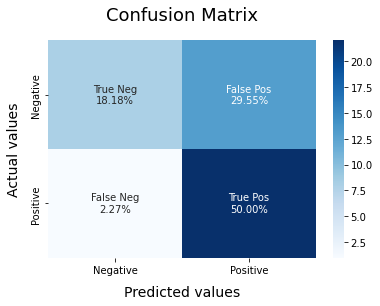

In [123]:
# konfusi matriks dari model menggunakan batch size 64 dan epochs 10

import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

def ConfusionMatrix(y_pred, y_test):
    # Compute and plot the Confusion matrix
    cf_matrix = confusion_matrix(y_test, y_pred)

    categories  = ['Negative','Positive']
    group_names = ['True Neg','False Pos', 'False Neg','True Pos']
    group_percentages = ['{0:.2%}'.format(value) for value in cf_matrix.flatten() / np.sum(cf_matrix)]

    labels = [f'{v1}\n{v2}' for v1, v2 in zip(group_names,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)

    sns.heatmap(cf_matrix, annot = labels, cmap = 'Blues',fmt = '',
                xticklabels = categories, yticklabels = categories)

    plt.xlabel("Predicted values", fontdict = {'size':14}, labelpad = 10)
    plt.ylabel("Actual values"   , fontdict = {'size':14}, labelpad = 10)
    plt.title ("Confusion Matrix", fontdict = {'size':18}, pad = 20)

# Predicting on the Test dataset.
y_pred = model.predict(x_test)

# Converting prediction to reflect the sentiment predicted.
y_pred = np.where(y_pred>=0.5, 1, 0)

# Printing out the Evaluation metrics. 
ConfusionMatrix(y_pred, y_test)

<h1>Eksperimen splitting data dengan model terpilih</h1>

In [596]:
x_train, x_test, y_train, y_test = train_test_split(x_train_lstm, y_lstm, test_size=0.1, random_state=42)

In [597]:
model = Sequential()
model.add(LSTM(64, input_shape=(None, 1000)))
model.add(Dropout(0.1))
model.add(Dense(256, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.compile(loss='binary_crossentropy', optimizer=Adam(), metrics = ['accuracy',tf.keras.metrics.Precision(),tf.keras.metrics.Recall()])
model.summary()

Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_71 (LSTM)              (None, 64)                272640    
                                                                 
 dropout_71 (Dropout)        (None, 64)                0         
                                                                 
 dense_138 (Dense)           (None, 256)               16640     
                                                                 
 dense_139 (Dense)           (None, 128)               32896     
                                                                 
 dense_140 (Dense)           (None, 1)                 129       
                                                                 
Total params: 322,305
Trainable params: 322,305
Non-trainable params: 0
_________________________________________________________________


In [598]:
# csv_logger = CSVLogger('training_split9010.log', separator=',', append=False)
history = model.fit(x_train,y_train,validation_data=(x_test,y_test),batch_size=64, epochs=10)

Epoch 1/10
4/4 [==============================] - 4s 352ms/step - loss: 0.6931 - accuracy: 0.5000 - precision_12: 0.5547 - recall_12: 0.6396 - val_loss: 0.6900 - val_accuracy: 0.5909 - val_precision_12: 0.5909 - val_recall_12: 1.0000
Epoch 2/10
4/4 [==============================] - 0s 52ms/step - loss: 0.6888 - accuracy: 0.5722 - precision_12: 0.5722 - recall_12: 1.0000 - val_loss: 0.6884 - val_accuracy: 0.5909 - val_precision_12: 0.5909 - val_recall_12: 1.0000
Epoch 3/10
4/4 [==============================] - 0s 52ms/step - loss: 0.6848 - accuracy: 0.5722 - precision_12: 0.5722 - recall_12: 1.0000 - val_loss: 0.6829 - val_accuracy: 0.5909 - val_precision_12: 0.5909 - val_recall_12: 1.0000
Epoch 4/10
4/4 [==============================] - 0s 50ms/step - loss: 0.6772 - accuracy: 0.5722 - precision_12: 0.5722 - recall_12: 1.0000 - val_loss: 0.6770 - val_accuracy: 0.5909 - val_precision_12: 0.5909 - val_recall_12: 1.0000
Epoch 5/10
4/4 [==============================] - 0s 54ms/step - lo

In [599]:
# model.save('training split 90 10')

INFO:tensorflow:Assets written to: training split 90 10\assets


INFO:tensorflow:Assets written to: training split 90 10\assets


In [10]:
import pandas as pd

eksperimen_split1 = pd.read_csv('training_split7030.log', sep=',', engine='python')
eksperimen_split2 = pd.read_csv('training_split9010.log', sep=',', engine='python')

In [27]:
split_70_30 = eksperimen_split1.tail(1).drop('epoch',1)
f1_score = (2 * split_70_30['precision_11'] * split_70_30['recall_11'])/(split_70_30['precision_11'] + split_70_30['recall_11'])
val_f1_score = (2 * split_70_30['val_precision_11'] * split_70_30['val_recall_11'])/(split_70_30['val_precision_11'] + split_70_30['val_recall_11'])
split_70_30.insert(loc=4, column='f1_score', value=f1_score)
split_70_30.insert(loc=9, column='val_f1_score', value=val_f1_score)

C:\Users\Muhith\AppData\Local\Temp/ipykernel_264/2374476903.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  split_70_30 = eksperimen_split1.tail(1).drop('epoch',1)


In [28]:
split_70_30

,accuracy,loss,precision_11,recall_11,f1_score,val_accuracy,val_loss,val_precision_11,val_recall_11,val_f1_score
9,0.827815,0.41427,0.778761,0.988764,0.871287,0.584615,0.753131,0.566667,0.971429,0.715789


In [29]:
split_90_10 = eksperimen_split2.tail(1).drop('epoch',1)
f1_score = (2 * split_90_10['precision_12'] * split_90_10['recall_12'])/(split_90_10['precision_12'] + split_90_10['recall_12'])
val_f1_score = (2 * split_90_10['val_precision_12'] * split_90_10['val_recall_12'])/(split_90_10['val_precision_12'] + split_90_10['val_recall_12'])
split_90_10.insert(loc=4, column='f1_score', value=f1_score)
split_90_10.insert(loc=9, column='val_f1_score', value=val_f1_score)

C:\Users\Muhith\AppData\Local\Temp/ipykernel_264/2273799151.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  split_90_10 = eksperimen_split2.tail(1).drop('epoch',1)


In [30]:
split_90_10

,accuracy,loss,precision_12,recall_12,f1_score,val_accuracy,val_loss,val_precision_12,val_recall_12,val_f1_score
9,0.634021,0.598549,0.60989,1.0,0.757679,0.590909,0.67786,0.590909,1.0,0.742857
